<a href="https://colab.research.google.com/github/rmitra97/ark.AI/blob/main/EV_Charging_Station_Optimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ML Project Submission by Team 18: Zeel Shah, Rashmila Mitra and Arjun Lamba

# Step 1: Data Cleaning & Preprocessing

## 1.1 Loading the Dataset & Cleaning it

Removed 500 rows where city was 'Country'.



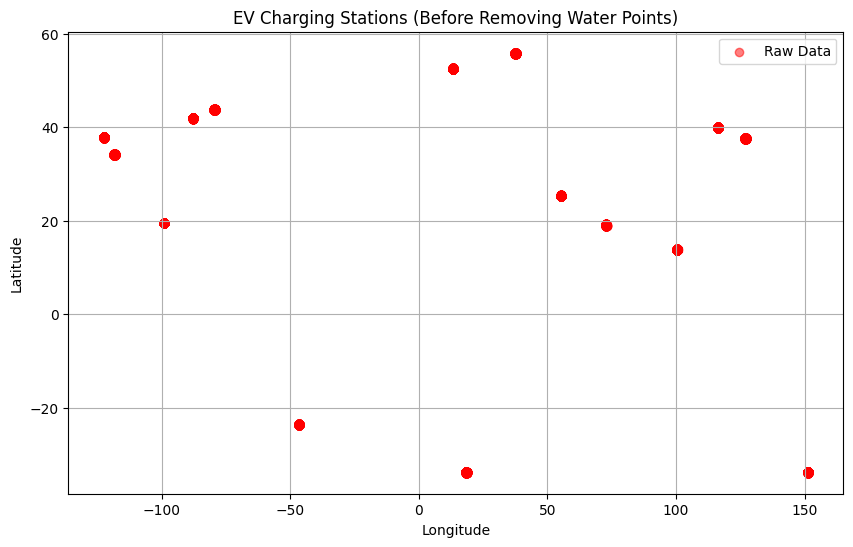

Total EV Charging Stations BEFORE Cleaning: 4500



In [ ]:
# Importing general libraries

import pandas as pd
import matplotlib.pyplot as plt

# Loading the data
file_path = "/content/drive/MyDrive/detailed_ev_charging_stations_with_city.csv"
df = pd.read_csv(file_path)

# Standardsing the column names
df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_")

# Removing invalid rows i.e. where'city' == 'Country'
initial_count = len(df)
df = df[df['city'] != 'Country']
removed_cities = initial_count - len(df)
print(f"Removed {removed_cities} rows where city was 'Country'.\n")

# Plotting the raw data
plt.figure(figsize=(10, 6))
plt.scatter(df['longitude'], df['latitude'], c='red', alpha=0.5, label="Raw Data")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("EV Charging Stations (Before Removing Water Points)")
plt.legend()
plt.grid(True)
plt.show()

# Countting the total stations before cleaning
print(f"Total EV Charging Stations BEFORE Cleaning: {len(df)}\n")


In [ ]:
# Importing the Folium Library for Mapping

import folium

# Creating a BASE map that will be centered at the mean location of stations
center_lat, center_long = df['latitude'].mean(), df['longitude'].mean()
map_before = folium.Map(location=[center_lat, center_long], zoom_start=6)

# Add charging stations to the map (Before Cleaning)
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        popup=f"City: {row['city']}"
    ).add_to(map_before)

# Saving and displaying the map
map_before.save("EV_Charging_Before_Cleaning.html")
map_before


After filtering using ShapeFile (.shp) we have succesfully removed 730 water locations.


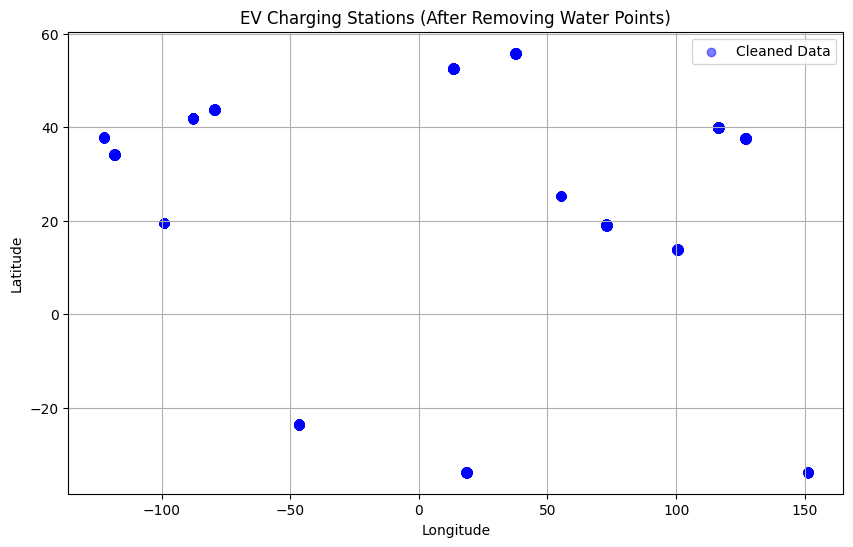

Therefore, total EV Charging Stations AFTER Cleaning: 3770


In [ ]:
# Importing library for removing water datapoints thaty were shown on the map

import geopandas as gpd
from shapely.geometry import Point

# Loading land shapefile
land = gpd.read_file("/content/drive/MyDrive/10m_physical/ne_10m_land.shp")


# FYI: This shapefile was downloaded from Natural Earth (https://www.naturalearthdata.com/downloads/) and 10m land precision file was used.

# Defining a fxn that checks if a coordinate is on land (using a land polygon shapefile.

def is_on_land(lat, lon):
    point = Point(lon, lat)
    return any(land.contains(point))

# Defining a fxn that removes stations that are in water using a land mask.
def filter_stations_by_land(df):
    df["is_land"] = df.apply(lambda row: is_on_land(row["latitude"], row["longitude"]), axis=1)
    df_filtered = df[df["is_land"] == True].drop(columns=["is_land"])
    print(f"After filtering using ShapeFile (.shp) we have succesfully removed {len(df) - len(df_filtered)} water locations.")
    return df_filtered

# Applying land filtering
df_cleaned = filter_stations_by_land(df)

# Saving cleaned dataset
cleaned_file_path = "/content/drive/MyDrive/cleaned_ev_charging_stations.csv"
df_cleaned.to_csv(cleaned_file_path, index=False)

# Plotting cleaned data
plt.figure(figsize=(10, 6))
plt.scatter(df_cleaned['longitude'], df_cleaned['latitude'], c='blue', alpha=0.5, label="Cleaned Data")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("EV Charging Stations (After Removing Water Points)")
plt.legend()
plt.grid(True)
plt.show()

# Countting the total stations after cleaning
print(f"Therefore, total EV Charging Stations AFTER Cleaning: {len(df_cleaned)}")


In [ ]:
# Creating a BASE map centered at the mean location of the CLEANED stations
center_lat, center_long = df_cleaned['latitude'].mean(), df_cleaned['longitude'].mean()
map_after = folium.Map(location=[center_lat, center_long], zoom_start=6)

# Adding charging stations to the map (After Cleaning)
for _, row in df_cleaned.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.7,
        popup=f"City: {row['city']}"
    ).add_to(map_after)

# Saving and displaing the cleaned map
map_after.save("EV_Charging_After_Cleaning.html")
map_after


# Step 2: Exploratory Data Analysis (EDA)

## 2.1 Summary Statistics & Missing Values

In [ ]:
# Importing libraries
import seaborn as sns

# Displaying the dataset summary
print("Summary Statistics:\n", df_cleaned.describe())

# Checking for missing values
missing_values = df_cleaned.isnull().sum()
print("\nMissing Values:\n", missing_values)


Summary Statistics:
           latitude    longitude  cost_(usd/kwh)  distance_to_city_(km)  \
count  3770.000000  3770.000000     3770.000000            3770.000000   
mean     24.770929     6.291219        0.301836              10.205708   
std      27.008826    91.115992        0.115922               5.588120   
min     -33.899305  -122.499694        0.100000               0.500000   
25%      18.901092   -87.676493        0.200000               5.522500   
50%      37.519318    13.495101        0.300000              10.210000   
75%      41.932186   100.489854        0.400000              14.877500   
max      55.899682   151.314901        0.500000              20.000000   

       usage_stats_(avg_users/day)  charging_capacity_(kw)  installation_year  \
count                  3770.000000             3770.000000        3770.000000   
mean                     55.194430              142.232361        2016.601061   
std                      26.672729              127.642547           

In [ ]:
# Printting column names again before preprocessing
print("Columns in df_cleaned before preprocessing:\n", df_cleaned.columns.tolist())

# Checking if 'availability' column is actually in the DataFrame itself first.
if 'availability' in df_cleaned.columns:
    print("'availability' column exists. Proceeding with preprocessing.")
else:
    print("ERROR: 'availability' column is MISSING. Something is wrong.")


Columns in df_cleaned before preprocessing:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_(usd/kwh)', 'availability', 'distance_to_city_(km)', 'usage_stats_(avg_users/day)', 'station_operator', 'charging_capacity_(kw)', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_(rating)', 'parking_spots', 'maintenance_frequency', 'city']
'availability' column exists. Proceeding with preprocessing.


## 2.2 Renaming Columns to Standard Format

In [ ]:
# Renaming columns to match expected variable names and keeping our work easy
df_cleaned.rename(columns={
    'cost_(usd/kwh)': 'cost_usd_per_kwh',
    'distance_to_city_(km)': 'distance_to_city_km',
    'usage_stats_(avg_users/day)': 'usage_stats_avg_users_per_day',
    'charging_capacity_(kw)': 'charging_capacity_kw',
    'reviews_(rating)': 'reviews_rating'
}, inplace=True)

# Here, we are printing new column names for confirmation
print("Updated Column Names in df_cleaned:\n", df_cleaned.columns)


Updated Column Names in df_cleaned:
 Index(['station_id', 'latitude', 'longitude', 'address', 'charger_type',
       'cost_usd_per_kwh', 'availability', 'distance_to_city_km',
       'usage_stats_avg_users_per_day', 'station_operator',
       'charging_capacity_kw', 'connector_types', 'installation_year',
       'renewable_energy_source', 'reviews_rating', 'parking_spots',
       'maintenance_frequency', 'city'],
      dtype='object')


## 2.3 Preprocessing & Feature Engineering

In [ ]:
# Imporing libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Definign a fxn that prepares data for EDA and clustering.
def preprocess_data(df):
    # Printing available column names before any modifications
    print("Columns at START of preprocessing:\n", df.columns.tolist())

    # Converting categorical variables
    categorical_columns = ['installation_year', 'renewable_energy_source', 'availability']
    for col in categorical_columns:
        if col in df.columns:
            df[col] = df[col].astype('category')
        else:
            print(f"Warning: Column '{col}' is missing before conversion.")

    print("Columns after categorical conversion:\n", df.columns.tolist())

    # Normalizing the numerical features
    numerical_columns = ['cost_usd_per_kwh', 'distance_to_city_km', 'usage_stats_avg_users_per_day',
                         'charging_capacity_kw', 'reviews_rating', 'parking_spots']

    # Applying scaling only to existing numerical columns
    existing_numerical_columns = [col for col in numerical_columns if col in df.columns]
    scaler = MinMaxScaler()
    df[existing_numerical_columns] = scaler.fit_transform(df[existing_numerical_columns])

    print("Columns after Normalization:\n", df.columns.tolist())


    # One-Hot Encoding for categorical variables
    categorical_encoding_columns = ['charger_type', 'availability', 'station_operator',
                                    'connector_types', 'maintenance_frequency']

    # Only encoding categorical columns that exist
    existing_categorical_columns = [col for col in categorical_encoding_columns if col in df.columns]

    if existing_categorical_columns:
        df_encoded = pd.get_dummies(df, columns=existing_categorical_columns, drop_first=True)
    else:
        df_encoded = df.copy()

    # Print columns after encoding
    print("Columns AFTER One-Hot Encoding:\n", df_encoded.columns.tolist())

    return df_encoded

df_processed = preprocess_data(df_cleaned)


Columns at START of preprocessing:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_rating', 'parking_spots', 'maintenance_frequency', 'city']
Columns after categorical conversion:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_rating', 'parking_spots', 'maintenance_frequency', 'city']
Columns after Normalization:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types

## 2.4 Charging Station Distribution Visualization

In [ ]:
# Defining a fxn that visualizes the spatial distribution of charging stations.
def plot_station_distribution(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['longitude'], df['latitude'], alpha=0.5, s=10, color='blue')
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("EV Charging Stations Distribution")
    plt.grid(True)
    plt.show()


## 2.5 Charging Station Density (Hexbin Plot)

In [ ]:
# Defining a fxn that creates a hexbin map to visualize station density.
def plot_station_density(df):
    plt.figure(figsize=(10, 6))
    hb = plt.hexbin(df['longitude'], df['latitude'], gridsize=50, cmap='Reds', alpha=0.7)
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("EV Charging Station Density Map")
    plt.colorbar(hb, label="Density of Charging Stations")
    plt.grid(True)
    plt.show()


## 2.6  Availability Impact on Usage

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# defining a fxn that analyzes the impact of availability on station utilization.
def plot_availability_vs_usage(df):

    # Finding  all one-hot encoded 'availability' columns
    availability_columns = [col for col in df.columns if col.startswith('availability_')]

    if not availability_columns:
        print("No availability columns found after encoding. Skipping this plot.")
        return

    # Convertingf one-hot encoding back to categorical labels
    df['availability_category'] = df[availability_columns].idxmax(axis=1).str.replace('availability_', '')
    # plotting
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=df['availability_category'], y=df['usage_stats_avg_users_per_day'])
    plt.xlabel("Availability Hours")
    plt.ylabel("Average Users Per Day")
    plt.title("Impact of Availability on Station Utilization")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.show()


## 2.7 Usage Distribution

In [ ]:
# Defining a fxn that shows the distribution of charging station usage.
def plot_usage_distribution(df):
    plt.figure(figsize=(10, 6))
    sns.histplot(df['usage_stats_avg_users_per_day'], bins=30, kde=True, color="red")
    plt.xlabel("Average Users Per Day")
    plt.ylabel("Count of Stations")
    plt.title("Distribution of Charging Station Utilization")
    plt.grid(True)
    plt.show()


## 2.8 Correlation Analysis

In [ ]:
# Defining a fxn that plots a heatmap of feature correlations.
def plot_correlation_matrix(df):
    correlation_features = ['latitude', 'longitude', 'distance_to_city_km',
                            'usage_stats_avg_users_per_day', 'cost_usd_per_kwh',
                            'charging_capacity_kw', 'reviews_rating']

    correlation_matrix = df[correlation_features].corr()

    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title("Feature Correlation Heatmap")
    plt.show()

    return correlation_matrix


## 2.9 Full EDA Execution

Columns at START of preprocessing:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_rating', 'parking_spots', 'maintenance_frequency', 'city']
Columns after categorical conversion:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_rating', 'parking_spots', 'maintenance_frequency', 'city']
Columns after Normalization:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types

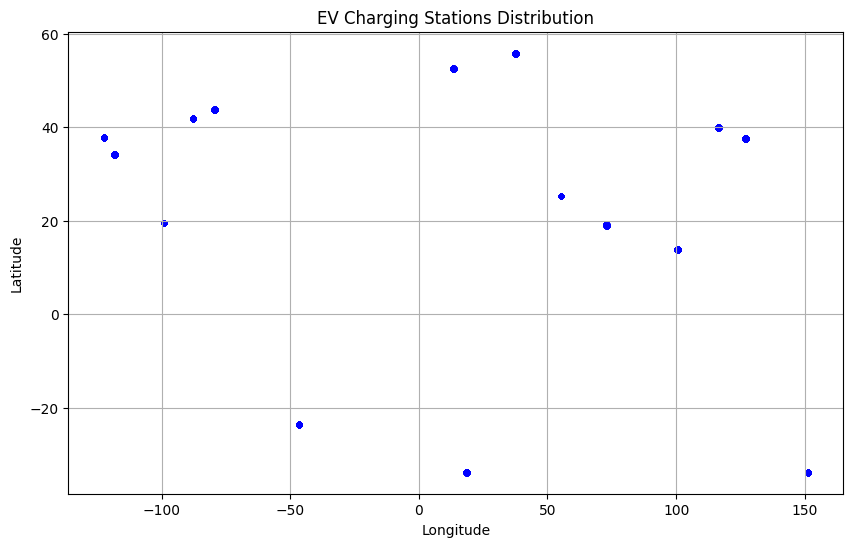

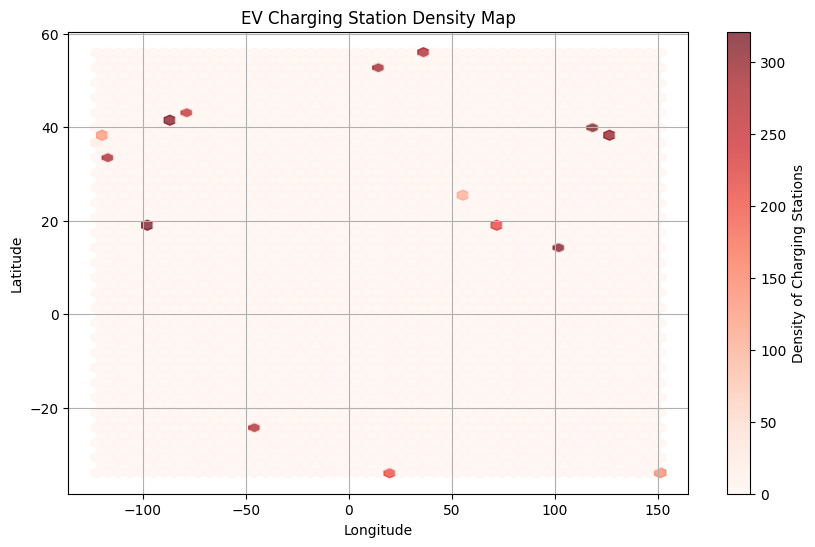

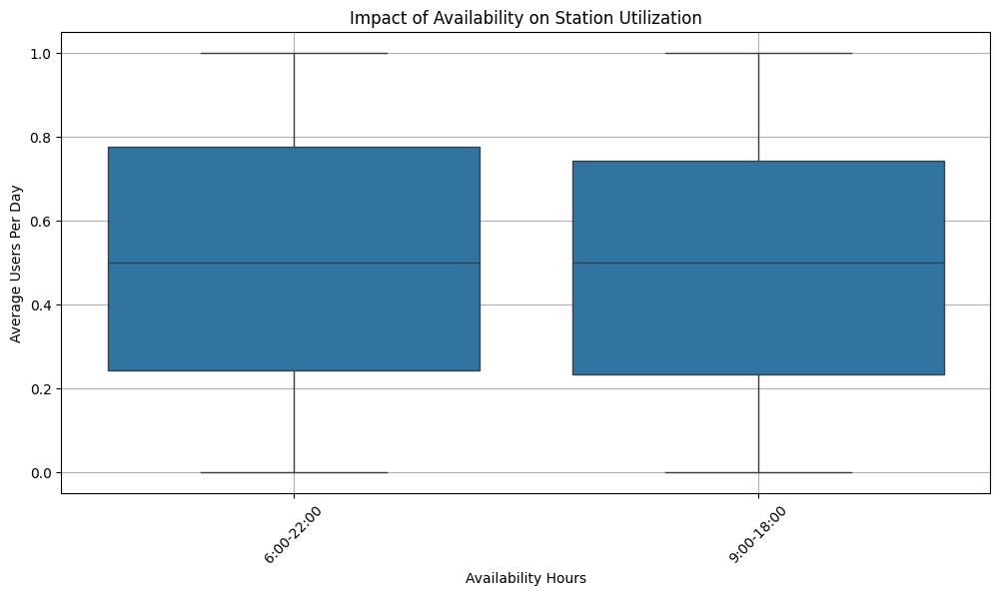

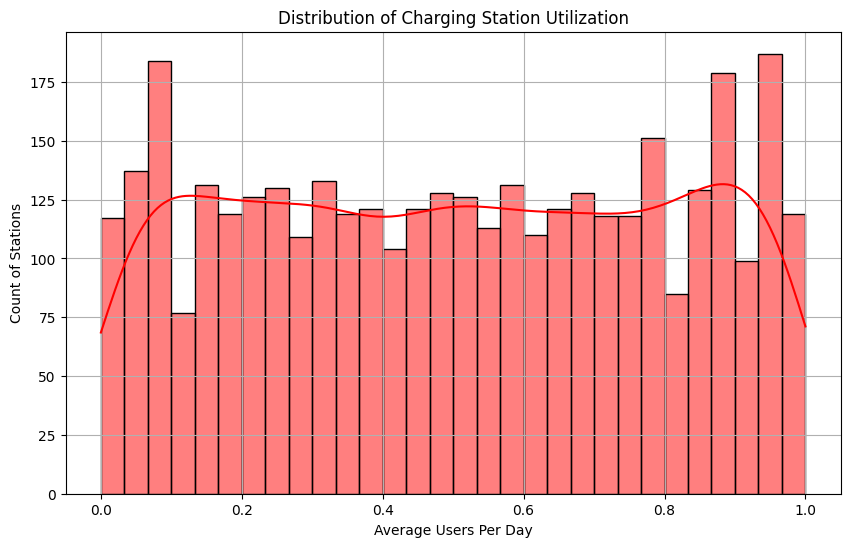

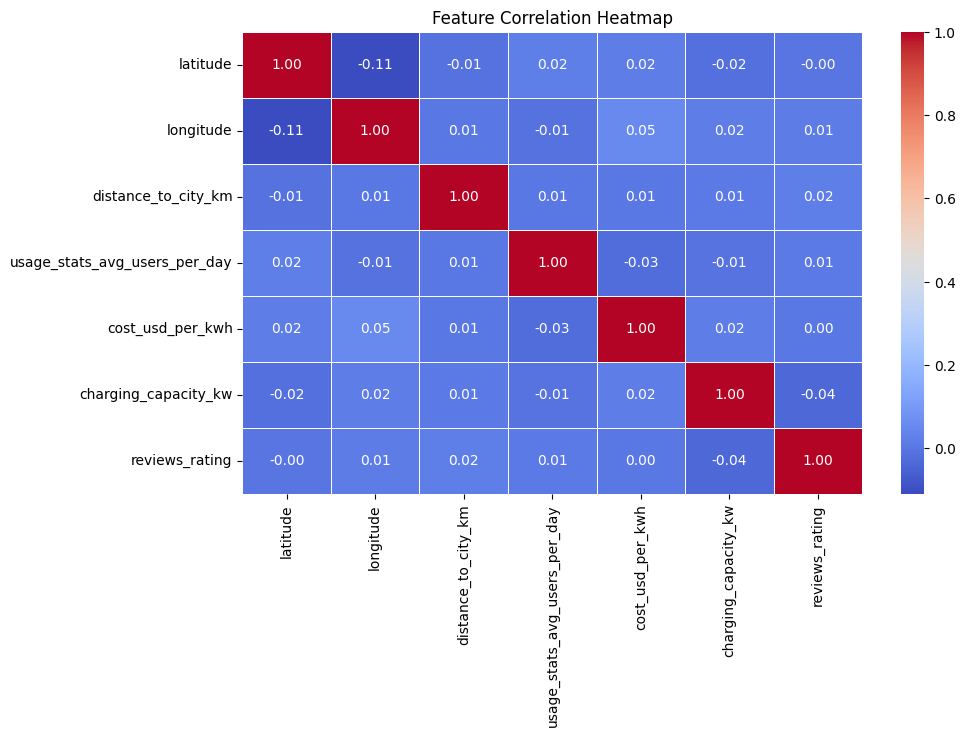

EDA Complete.


In [ ]:
# Running preprocessing after renaming columns
df_processed = preprocess_data(df_cleaned)

# Running EDA only and only if preprocessing was successful
if df_processed is not None:
    plot_station_distribution(df_processed)
    plot_station_density(df_processed)
    plot_availability_vs_usage(df_processed)
    plot_usage_distribution(df_processed)
    correlation_matrix = plot_correlation_matrix(df_processed)
    # Prinint the status of EDA
    print("EDA Complete.")



# Step 3: Clustering of Charging Stations

## 3.1 Extract & Scale Geospatial Data

In [ ]:
# Importing libraries
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

# Extracting relevant columns for clustering
geo_data = df_processed[['latitude', 'longitude']].dropna()

# Standardizing the data using StandardScaler
scaler = StandardScaler()
geo_data_scaled = scaler.fit_transform(geo_data)


## 3.2 Find the Optimal Number of Clusters (K)

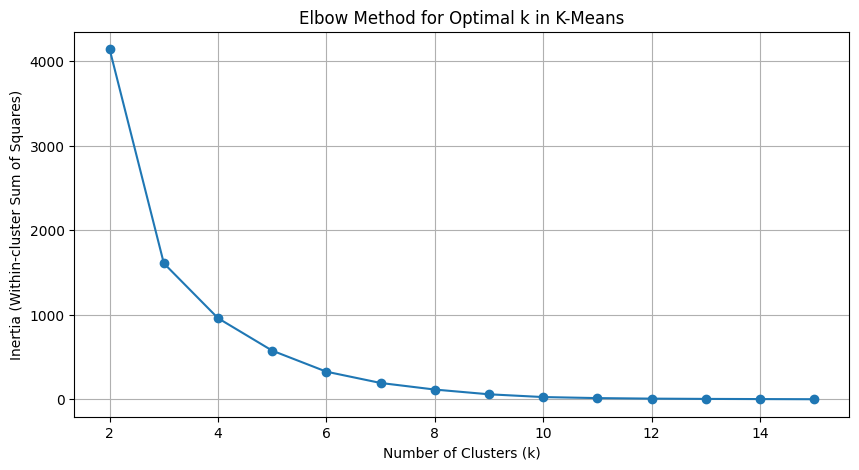

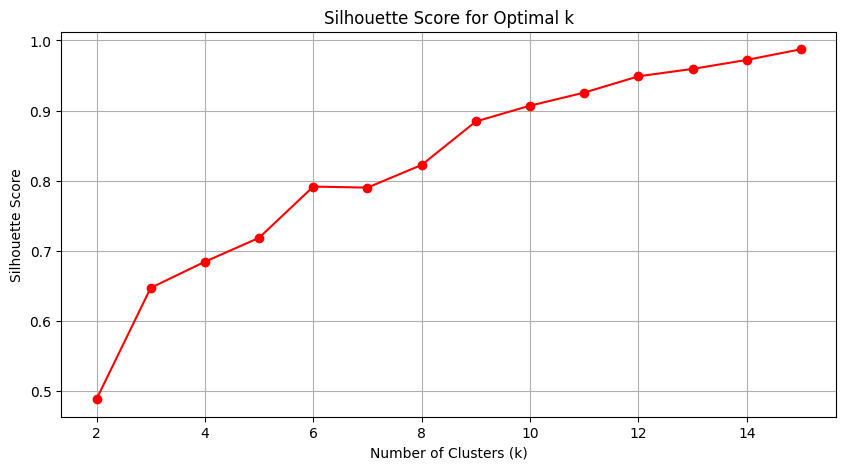

Optimal number of clusters: 15


In [ ]:
# Determining the optimal number of clusters
inertia = []
silhouette_scores = []
k_values = range(2, 16)  # Testing cluster values from 2 to 15

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(geo_data_scaled)
    inertia.append(kmeans.inertia_)

    # Calculating silhouette score (higher is better)
    silhouette_scores.append(silhouette_score(geo_data_scaled, kmeans.labels_))

# Plotting Elbow Plot
plt.figure(figsize=(10, 5))
plt.plot(k_values, inertia, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Within-cluster Sum of Squares)")
plt.title("Elbow Method for Optimal k in K-Means")
plt.grid(True)
plt.show()

# Plotting Silhouette Score
plt.figure(figsize=(10, 5))
plt.plot(k_values, silhouette_scores, marker='o', linestyle='-', color='r')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score for Optimal k")
plt.grid(True)
plt.show()

# Determining optimal k (highest silhouette score)
optimal_k = k_values[np.argmax(silhouette_scores)]
print(f"Optimal number of clusters: {optimal_k}")


## 3.3 Apply K-Means Clustering

In [ ]:
# Applying K-Means Clustering using optimal k
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
df_processed['cluster'] = kmeans.fit_predict(geo_data_scaled)


## 3.4 Visualize Clusters

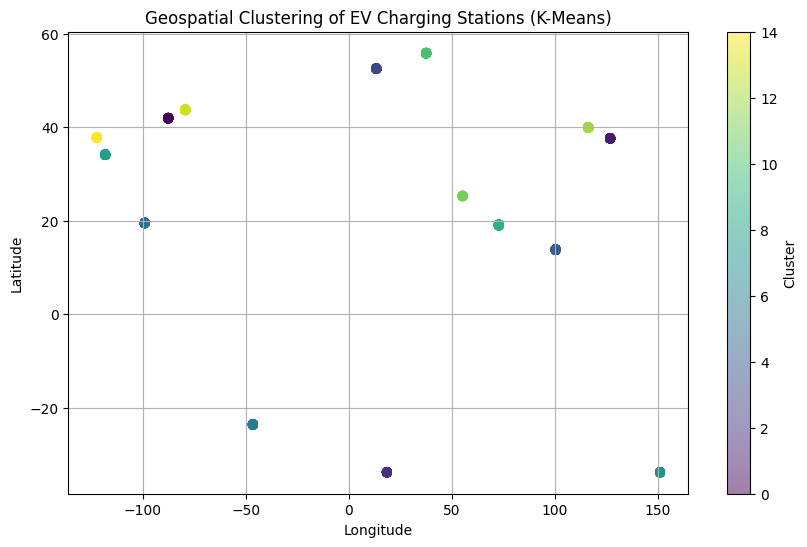

In [ ]:
# Plotting clustered charging stations
plt.figure(figsize=(10, 6))
plt.scatter(df_processed['longitude'], df_processed['latitude'], c=df_processed['cluster'], cmap='viridis', alpha=0.5)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Geospatial Clustering of EV Charging Stations (K-Means)")
plt.colorbar(label="Cluster")
plt.grid(True)
plt.show()


## 3.5 Assign City Names to Clusters & Save it

In [ ]:
# Finding the most frequent city in each cluster
cluster_city_mapping = df_processed.groupby('cluster')['city'].agg(lambda x: x.mode()[0])
print("\nCluster to City Mapping:")
print(cluster_city_mapping)

# Creating a new column with human-readable cluster names
df_processed['cluster_city_name'] = df_processed['cluster'].map(cluster_city_mapping)

# Saving dataset with named clusters
clustered_named_file_path = "/content/drive/MyDrive/clustered_ev_charging_stations_with_city_names.csv"
df_processed.to_csv(clustered_named_file_path, index=False)

# Displaying the cluster-wise station count with city names
cluster_counts = df_processed.groupby(['cluster', 'cluster_city_name']).size().reset_index(name='count')
print("\nCluster-wise station count with city names:")
print(cluster_counts)



Cluster to City Mapping:
cluster
0           Chicago
1             Seoul
2         Cape Town
3            Berlin
4           Bangkok
5       Mexico City
6         São Paulo
7            Sydney
8       Los Angeles
9            Mumbai
10           Moscow
11            Dubai
12          Beijing
13          Toronto
14    San Francisco
Name: city, dtype: object

Cluster-wise station count with city names:
    cluster cluster_city_name  count
0         0           Chicago    308
1         1             Seoul    299
2         2         Cape Town    208
3         3            Berlin    292
4         4           Bangkok    314
5         5       Mexico City    321
6         6         São Paulo    279
7         7            Sydney    140
8         8       Los Angeles    286
9         9            Mumbai    216
10       10            Moscow    281
11       11             Dubai    104
12       12           Beijing    319
13       13           Toronto    257
14       14     San Francisco    146


## 3.6 City-wise Cluster EDA

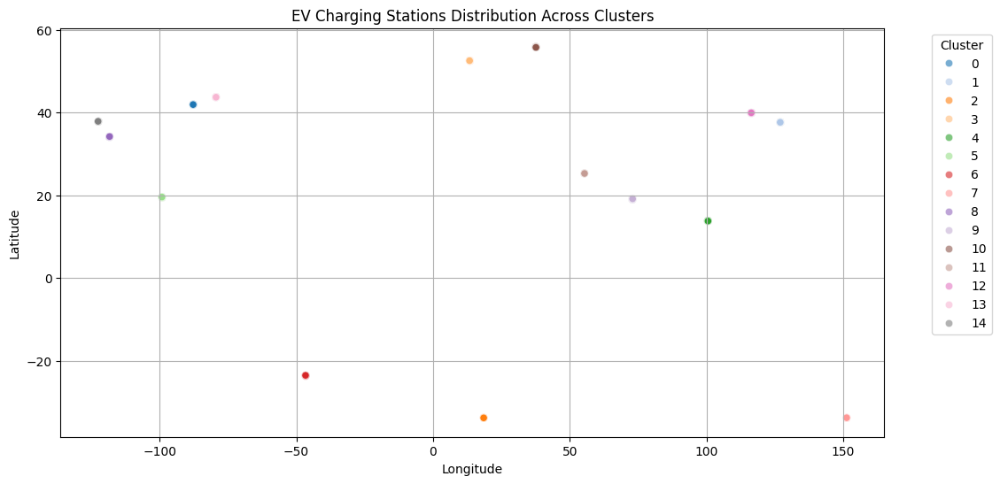

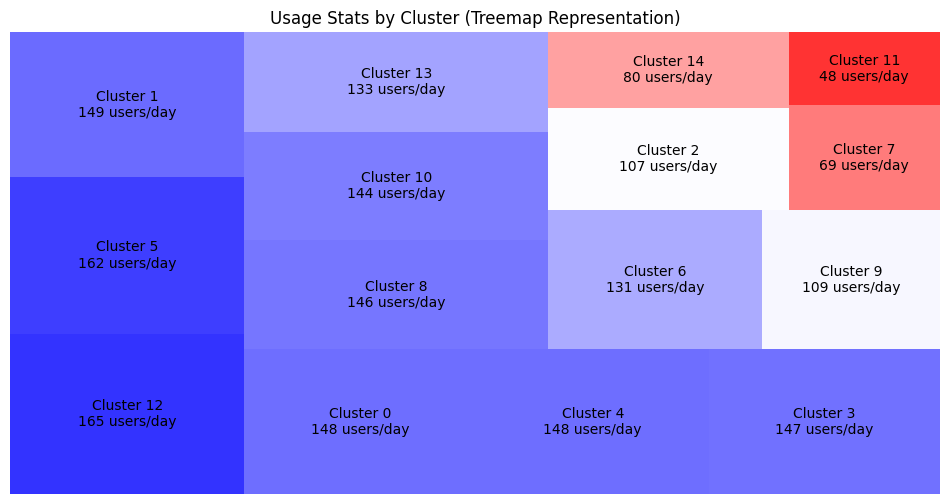


Total Users per Cluster (Sorted High to Low):
Cluster 12: 165 users/day
Cluster 5: 162 users/day
Cluster 1: 149 users/day
Cluster 0: 148 users/day
Cluster 4: 148 users/day
Cluster 3: 147 users/day
Cluster 8: 146 users/day
Cluster 10: 144 users/day
Cluster 13: 133 users/day
Cluster 6: 131 users/day
Cluster 9: 109 users/day
Cluster 2: 107 users/day
Cluster 14: 80 users/day
Cluster 7: 69 users/day
Cluster 11: 48 users/day


<ipython-input-22-634e20e92566>:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x=cluster_column, y='usage_stats_avg_users_per_day', palette='coolwarm_r', order=clusters)


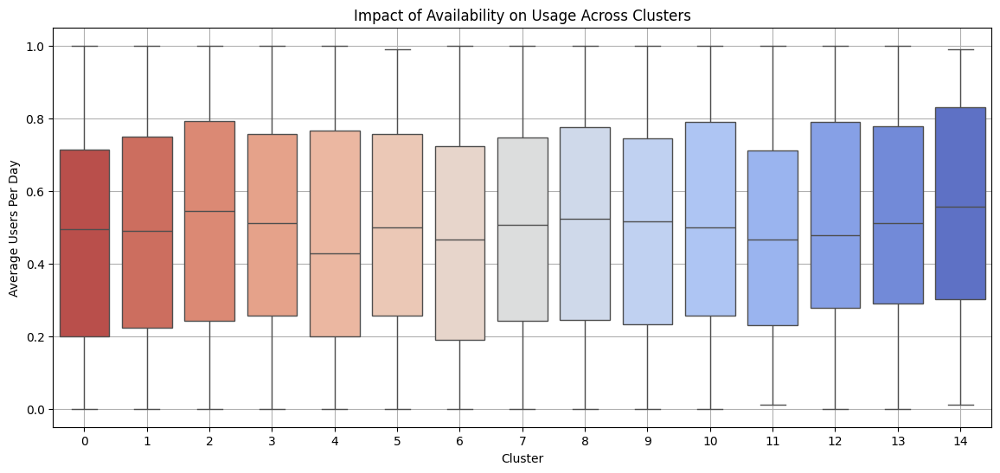

<ipython-input-22-634e20e92566>:65: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x=cluster_column, y='usage_stats_avg_users_per_day', palette='coolwarm_r', order=clusters, inner='quartile')


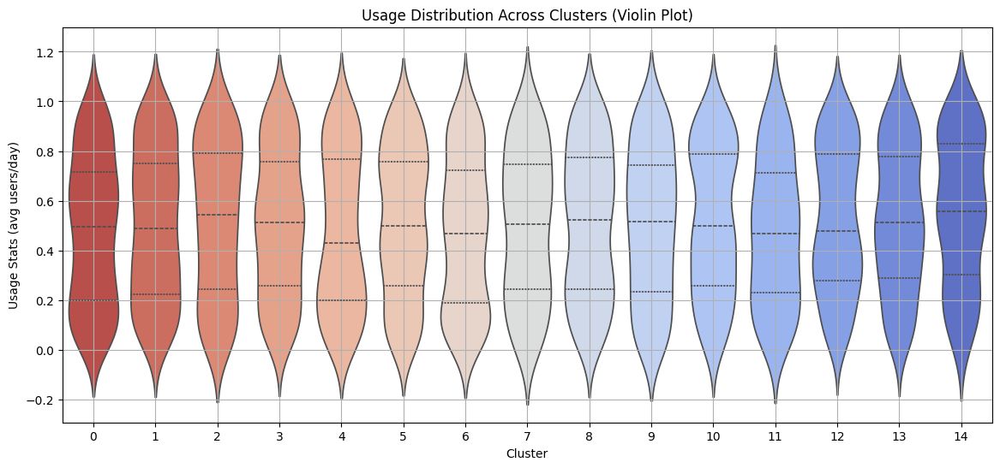

In [ ]:
!pip install squarify
import squarify  # For treemap visualization
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.colors as mcolors

# Defining a fxn that generates EDA plots for city clusters after clustering is done.
def perform_eda_city_clusters(df, cluster_column='cluster'):
    # Sort clusters in ascending order
    df = df.sort_values(by=[cluster_column])
    clusters = sorted(df[cluster_column].unique())

    # 1. Scattterplot for Charging Station Distribution
    plt.figure(figsize=(12, 6))
    scatter = sns.scatterplot(data=df, x='longitude', y='latitude', hue=cluster_column, palette='tab20', alpha=0.6)
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("EV Charging Stations Distribution Across Clusters")

    # Ensuring all clusters appear in the legend
    handles, labels = scatter.get_legend_handles_labels()
    unique_labels = list(dict.fromkeys(labels))  # Remove duplicates
    scatter.legend(handles=handles[:len(unique_labels)], title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.grid(True)
    plt.show()

    # 2. Treemap for Usage Stats Treemap (Gradient Color: Red → White → Blue)
    cluster_usage = df.groupby(cluster_column)['usage_stats_avg_users_per_day'].sum().sort_values(ascending=False)

    # Generating a color gradient from Red (low) → White (mid) → Blue (high)
    cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", ["red", "white", "blue"])
    norm = plt.Normalize(min(cluster_usage), max(cluster_usage))
    colors = [cmap(norm(value)) for value in cluster_usage]

    # Creating the treemap
    plt.figure(figsize=(12, 6))
    squarify.plot(
        sizes=cluster_usage,
        label=[f"Cluster {i}\n{int(v)} users/day" for i, v in cluster_usage.items()],
        alpha=0.8,
        color=colors
    )
    plt.title("Usage Stats by Cluster (Treemap Representation)")
    plt.axis('off')
    plt.show()

    # Printing cluster User Stats for Clarity
    print("\nTotal Users per Cluster (Sorted High to Low):")
    for cluster, usage in cluster_usage.items():
        print(f"Cluster {cluster}: {int(usage)} users/day")

    # 3. Boxplot of all clusters showiing Availability vs. Usage Stats
    plt.figure(figsize=(14, 6))
    sns.boxplot(data=df, x=cluster_column, y='usage_stats_avg_users_per_day', palette='coolwarm_r', order=clusters)
    plt.xlabel("Cluster")
    plt.ylabel("Average Users Per Day")
    plt.title("Impact of Availability on Usage Across Clusters")
    plt.grid(True)
    plt.show()

    # 4. Violin plot for Improved Distribution of Charging Station Utilization
    plt.figure(figsize=(14, 6))
    sns.violinplot(data=df, x=cluster_column, y='usage_stats_avg_users_per_day', palette='coolwarm_r', order=clusters, inner='quartile')
    plt.xlabel("Cluster")
    plt.ylabel("Usage Stats (avg users/day)")
    plt.title("Usage Distribution Across Clusters (Violin Plot)")
    plt.grid(True)
    plt.show()

# Displating
perform_eda_city_clusters(df_processed, cluster_column='cluster')


# Step 4: Optimize New Charging Station Placement

## 4.1  Solve ILP for Optimal Placement

In [ ]:
import numpy as np
import folium
!pip install pulp
from pulp import LpMaximize, LpProblem, LpVariable, lpSum

# Defining a fxn that optimizes new charging station placement using Integer Linear Programming (ILP) & ensures stations are placed in high-demand and low-coverage areas.
def optimize_station_placement(df, num_new_stations=3):

    # Defining the Integer Linear Programming (ILP) problem
    prob = LpProblem("Charging_Station_Optimization", LpMaximize)
    df["New_Station_ILP"] = [LpVariable(f"station_{i}", cat="Binary") for i in df.index]

    # FYI: Our objective is to maximize station placement in high-demand areas
    prob += lpSum(df.loc[i, "New_Station_ILP"] * df.loc[i, "usage_stats_avg_users_per_day"] for i in df.index)

    # Limitting new stations per cluster to avoid over-concentration
    cluster_counts = df.groupby("cluster")["New_Station_ILP"].sum()
    for cluster in cluster_counts.index:
        prob += cluster_counts[cluster] <= num_new_stations  # Max new stations per cluster

    # Prioritizing high-demand areas i.e. only top 50% demand locations
    demand_threshold = df["usage_stats_avg_users_per_day"].median()
    for i in df.index:
        if df.loc[i, "usage_stats_avg_users_per_day"] < demand_threshold:
            prob += df.loc[i, "New_Station_ILP"] == 0

    # Preferring stations closer to city center i.e. in less than 10 km
    for i in df.index:
        if df.loc[i, "distance_to_city_km"] > 10:
            prob += df.loc[i, "New_Station_ILP"] == 0

    # Solving the optimization problem
    prob.solve()

    # Extracting optimized station locations
    df["Optimized_Station"] = [var.varValue for var in df["New_Station_ILP"]]

    print(f"Total new stations recommended: {df['Optimized_Station'].sum()}")
    print("Optimized station locations:\n", df[df["Optimized_Station"] == 1][["city", "latitude", "longitude"]])

    return df


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.7/17.7 MB 23.3 MB/s eta 0:00:00


## 4.2 Generate Completely New Stations (If Needed)
If the ILP does not allocate enough stations, generate new stations in high-demand clusters.

In [ ]:
# this fxn will Generates new locations near existing stations but ensures they are unique.

def generate_new_locations(existing_df, cluster_id, num_new_stations=3, max_distance=5):

    np.random.seed(42)  # For reproducibility
    cluster_df = existing_df[existing_df["cluster"] == cluster_id]

    new_stations = []
    existing_locations = set(zip(cluster_df["latitude"], cluster_df["longitude"]))

    for _ in range(num_new_stations):
        while True:
            # Generating a random shift in latitude/long. within max_distance km (~0.045 degrees)
            lat_shift = np.random.uniform(-0.045, 0.045)
            lon_shift = np.random.uniform(-0.045, 0.045)

            # Picking a random high-demand station as a reference point
            reference = cluster_df.sample(1)
            new_lat = reference["latitude"].values[0] + lat_shift
            new_lon = reference["longitude"].values[0] + lon_shift

            # Ensuring the new location is not already used
            if (new_lat, new_lon) not in existing_locations:
                new_stations.append((new_lat, new_lon))
                existing_locations.add((new_lat, new_lon))
                break

    return new_stations


## 4.3 Visualize Optimized & New Stations

In [ ]:
# this fxn plots optimized new station locations after ILP optimization.
def plot_optimized_stations(df, new_locations):

    center_lat, center_long = df['latitude'].mean(), df['longitude'].mean()
    map_stations = folium.Map(location=[center_lat, center_long], zoom_start=6)

    # Plotting existing stations
    for _, row in df.iterrows():
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.7,
            popup=f"Existing Station - {row['city']}"
        ).add_to(map_stations)

    # Plotting optimized stations
    df_new = df[df["Optimized_Station"] == 1]
    for _, row in df_new.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=f"Optimized Station - {row['city']}",
            icon=folium.Icon(color="red", icon="bolt")
        ).add_to(map_stations)

    # Plotting completely new locations
    for lat, lon in new_locations:
        folium.Marker(
            location=[lat, lon],
            popup="New Generated Station",
            icon=folium.Icon(color="green", icon="cloud")
        ).add_to(map_stations)

    print("Displaying optimized station placement map with new locations:")
    display(map_stations)

    return map_stations


## 4.4 Confirm df_cleaned Has Clustering Data

In [ ]:
print("Columns in df_cleaned:\n", df_cleaned.columns.tolist())

# Checkking if 'cluster' column exists
if 'cluster' in df_cleaned.columns:
    print("cluster' column exists. Proceeding with optimization.")
else:
    print("ERROR: 'cluster' column is missing! Clustering step was skipped.")


Columns in df_cleaned:
 ['station_id', 'latitude', 'longitude', 'address', 'charger_type', 'cost_usd_per_kwh', 'availability', 'distance_to_city_km', 'usage_stats_avg_users_per_day', 'station_operator', 'charging_capacity_kw', 'connector_types', 'installation_year', 'renewable_energy_source', 'reviews_rating', 'parking_spots', 'maintenance_frequency', 'city']
ERROR: 'cluster' column is missing! Clustering step was skipped.


## 4.5 Ensure Clustering is Done Before Optimization

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Extractting and scaling geospatial data
geo_data = df_cleaned[['latitude', 'longitude']].dropna()
scaler = StandardScaler()
geo_data_scaled = scaler.fit_transform(geo_data)

# Applying K-Means with optimal k
optimal_k = 15
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
df_cleaned['cluster'] = kmeans.fit_predict(geo_data_scaled)

print("Clustering applied. Now df_cleaned has a 'cluster' column.")


Clustering applied. Now df_cleaned has a 'cluster' column.


## 4.6 Run Optimization

In [ ]:
# 1. Optimizing existing locations
df_optimized = optimize_station_placement(df_cleaned)

# 2. Generating additional new stations (if needed)
new_station_locations = []
for cluster_id in df_cleaned["cluster"].unique():
    new_station_locations.extend(generate_new_locations(df_cleaned, cluster_id, num_new_stations=3))

# 3. Plotting the final optimized and newly generated stations
final_map = plot_optimized_stations(df_optimized, new_station_locations)


Total new stations recommended: 45.0
Optimized station locations:
                city   latitude   longitude
77           Sydney -33.756344  151.215081
362         Beijing  39.851482  116.465052
473         Toronto  43.654350  -79.353920
524         Bangkok  13.737150  100.500361
571       São Paulo -23.637169  -46.578441
582          Berlin  52.581127   13.308411
674          Berlin  52.541054   13.492239
689           Dubai  25.351373   55.380514
828          Mumbai  19.148460   72.945366
851         Chicago  41.813490  -87.673545
895         Bangkok  13.801422  100.569311
956   San Francisco  37.755637 -122.403703
1252        Beijing  39.964159  116.397439
1321        Toronto  43.726371  -79.351855
1372    Mexico City  19.546299  -99.191859
1482         Moscow  55.850415   37.643948
1563         Sydney -33.814797  151.236706
1776        Chicago  41.951822  -87.712888
1828    Los Angeles  34.086143 -118.246255
2051         Moscow  55.758091   37.681309
2084         Mumbai  19.154032

1. Existing Stations (🔵 Blue Dots)
  - Current charging infrastructure distribution across the world.
  - Some areas may have high density, while others maybe underserved.


2. Optimized New Stations (🔴 Red Markers)
  - Placed using ILP optimization in high-demand but low-coverage areas.
  - Prioritizes user accessibility and demand hotspots.


3. Generated New Stations (🟢 Green Markers)
  - Placed using geospatial randomization near high-demand zones.
  - Ensures balanced expansion without redundancy.


# Step 5: Feature Engineering & Data Preparation

In [ ]:
# Checking for missing columns
missing_features = ['availability_6:00-22:00', 'availability_9:00-18:00',
                    'charger_type_AC Level 1', 'charger_type_AC Level 2', 'charger_type_DC Fast Charger']
missing_in_df = [col for col in missing_features if col not in df_cleaned.columns]

print("Missing Columns:", missing_in_df)


Missing Columns: ['availability_6:00-22:00', 'availability_9:00-18:00', 'charger_type_AC Level 1', 'charger_type_AC Level 2', 'charger_type_DC Fast Charger']


In [ ]:
# Reapplying One-Hot Encoding
df_cleaned = pd.get_dummies(df_cleaned, columns=['availability', 'charger_type'], prefix=['availability', 'charger_type'])

# Re-checking missing features beofre heading towards Feature engineering
missing_in_df = [col for col in missing_features if col not in df_cleaned.columns]
print("Missing Columns After Encoding:", missing_in_df)


Missing Columns After Encoding: []


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# Fxn to prepare data for demand prediction by selecting features, encoding categories, and normalizing data.

def preprocess_demand_data(df):

    # 1. Selecting Predictor Variables
    features = [
        "cost_usd_per_kwh",
        "distance_to_city_km",
        "parking_spots",
        "availability_6:00-22:00",  # Encoded availability hours
        "availability_9:00-18:00",  # Encoded availability hours
        "renewable_energy_source",
        "charger_type_AC Level 1",
        "charger_type_AC Level 2",
        "charger_type_DC Fast Charger"
    ]

    target = "usage_stats_avg_users_per_day"  # Predicting demand

    # 2. Ensuring All Features Exist
    missing_features = [col for col in features if col not in df.columns]
    if missing_features:
        print(f"ERROR: Missing required features in df_cleaned: {missing_features}")
        return None, None, None, None

    # 3. Normalizing Numerical Features
    scaler = MinMaxScaler()
    df[["cost_usd_per_kwh", "distance_to_city_km", "parking_spots"]] = scaler.fit_transform(
        df[["cost_usd_per_kwh", "distance_to_city_km", "parking_spots"]]
    )

    # 4. Train-Test Split (80:20)
    X = df[features]
    y = df[target]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    print("Data Preprocessing Complete!")
    print(f"Training Samples: {len(X_train)}, Testing Samples: {len(X_test)}")

    return X_train, X_test, y_train, y_test

# Running data preprocessing
X_train, X_test, y_train, y_test = preprocess_demand_data(df_cleaned)


Data Preprocessing Complete!
Training Samples: 3016, Testing Samples: 754


# Step 6: Train a Demand Prediction Model

## 6.1 Train a Linear Regression Model

In [ ]:
# 1. Converting column to a new Series to fully detach from category type
df_cleaned['renewable_energy_source'] = df_cleaned['renewable_energy_source'].astype(str).copy()

# 2. Ensurign 'Yes' and 'No' are replaced properly
df_cleaned['renewable_energy_source'] = df_cleaned['renewable_energy_source'].map({'Yes': 1, 'No': 0})

# 3. Converting to numeric, forcing any unexpected values to NaN
df_cleaned['renewable_energy_source'] = pd.to_numeric(df_cleaned['renewable_energy_source'], errors='coerce')

# 4. Filling NaN values and converting to int
df_cleaned['renewable_energy_source'] = df_cleaned['renewable_energy_source'].fillna(0).astype(int)

# Final Check
print(df_cleaned['renewable_energy_source'].dtype)  # Should be int64
print(df_cleaned['renewable_energy_source'].unique())  # Should be [0, 1]


int64
[1 0]


In [ ]:
# Ensuring all columns are numeric
X_train = X_train.apply(pd.to_numeric, errors='coerce')
X_test = X_test.apply(pd.to_numeric, errors='coerce')

# Filingl any NaN values that might have been introduced
X_train.fillna(0, inplace=True)
X_test.fillna(0, inplace=True)


In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Trainning a Linear Regression Model
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Predicting on test set
y_pred_lr = lr_model.predict(X_test)

# Evaluating the model
r2_lr = r2_score(y_test, y_pred_lr)
mae_lr = mean_absolute_error(y_test, y_pred_lr)
rmse_lr = np.sqrt(mean_squared_error(y_test, y_pred_lr))

print("Linear Regression Model Performance:")
print(f"R² Score: {r2_lr:.4f}")
print(f"Mean Absolute Error (MAE): {mae_lr:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lr:.4f}")



Linear Regression Model Performance:
R² Score: -0.0080
Mean Absolute Error (MAE): 0.2523
Root Mean Squared Error (RMSE): 0.2928


## 6.2 Train an XGBoost Model

In [ ]:
from xgboost import XGBRegressor

# Trainning an XGBoost Model
xgb_model = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train, y_train)

# Predicting on test set
y_pred_xgb = xgb_model.predict(X_test)

# Evaluating the model
r2_xgb = r2_score(y_test, y_pred_xgb)
mae_xgb = mean_absolute_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(mean_squared_error(y_test, y_pred_xgb))

print("\nXGBoost Model Performance:")
print(f"R² Score: {r2_xgb:.4f}")
print(f"Mean Absolute Error (MAE): {mae_xgb:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_xgb:.4f}")



XGBoost Model Performance:
R² Score: -0.1421
Mean Absolute Error (MAE): 0.2658
Root Mean Squared Error (RMSE): 0.3117


## 6.3 Train a Random Forest Model

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# Trainning a Random Forest Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predicting on test set
y_pred_rf = rf_model.predict(X_test)

# Evaluating the model
r2_rf = r2_score(y_test, y_pred_rf)
mae_rf = mean_absolute_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(mean_squared_error(y_test, y_pred_rf))

print("\nRandom Forest Model Performance:")
print(f"R² Score: {r2_rf:.4f}")
print(f"Mean Absolute Error (MAE): {mae_rf:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_rf:.4f}")



Random Forest Model Performance:
R² Score: -0.1029
Mean Absolute Error (MAE): 0.2615
Root Mean Squared Error (RMSE): 0.3063


## 6.4 Hyperparameter Tuning with GridSearchCV

In [ ]:
from sklearn.model_selection import GridSearchCV

# Defining hyperparameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7]
}

# Performing GridSearchCV
grid_search = GridSearchCV(XGBRegressor(random_state=42), param_grid, cv=3, scoring='r2', n_jobs=-1)
grid_search.fit(X_train, y_train)

# Getting the best parameters
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

# Predicting on test set
y_pred_best = best_model.predict(X_test)

# Evaluating best model
r2_best = r2_score(y_test, y_pred_best)
mae_best = mean_absolute_error(y_test, y_pred_best)
rmse_best = np.sqrt(mean_squared_error(y_test, y_pred_best))

print("\nBest XGBoost Model (After Hyperparameter Tuning):")
print(f"Best Parameters: {best_params}")
print(f"R² Score: {r2_best:.4f}")
print(f"Mean Absolute Error (MAE): {mae_best:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_best:.4f}")



Best XGBoost Model (After Hyperparameter Tuning):
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}
R² Score: -0.0034
Mean Absolute Error (MAE): 0.2520
Root Mean Squared Error (RMSE): 0.2922


##  Demand-Based Clustering & Classification

## 6.5 Create Demand-Based Clusters Using K-Means

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Selecting demand-related features
demand_features = df_cleaned[[
    "usage_stats_avg_users_per_day",
    "cost_usd_per_kwh",
    "distance_to_city_km",
    "parking_spots"
]]

# Normalizing features
scaler = StandardScaler()
demand_features_scaled = scaler.fit_transform(demand_features)

# Fitting K-Means clustering (15 demand clusters)
kmeans_demand = KMeans(n_clusters=15, random_state=42, n_init=10)
df_cleaned["demand_cluster"] = kmeans_demand.fit_predict(demand_features_scaled)

# Check the distribution of demand clusters
print("Demand Cluster Distribution:")
print(df_cleaned["demand_cluster"].value_counts())


Demand Cluster Distribution:
demand_cluster
11    288
5     277
1     274
0     270
14    261
7     255
3     255
13    251
8     249
12    247
2     246
10    229
4     228
9     225
6     215
Name: count, dtype: int64


## 6.6 Train a Random Forest Classifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

# Defining features for classification
selected_features = [
    "cost_usd_per_kwh",
    "distance_to_city_km",
    "parking_spots",
    "charging_capacity_kw",
    "reviews_rating"
]

# Features (X) & Target (y)
X_class = df_cleaned[selected_features]
y_class = df_cleaned["demand_cluster"]

# Train-Test Split (80:20)
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(
    X_class, y_class, test_size=0.2, random_state=42
)

# Training Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=42)
rf_classifier.fit(X_train_class, y_train_class)

# Predictions
y_pred_class = rf_classifier.predict(X_test_class)

# Model Evaluation
accuracy = accuracy_score(y_test_class, y_pred_class)
print("\nRandom Forest Classification Performance:")
print(f"Accuracy: {accuracy:.4f}")
print("\nClassification Report:\n", classification_report(y_test_class, y_pred_class))



Random Forest Classification Performance:
Accuracy: 0.5133

Classification Report:
               precision    recall  f1-score   support

           0       0.54      0.82      0.65        56
           1       0.49      0.50      0.50        52
           2       0.56      0.57      0.57        49
           3       0.51      0.55      0.53        47
           4       0.61      0.48      0.54        52
           5       0.42      0.46      0.44        48
           6       0.35      0.34      0.35        41
           7       0.39      0.18      0.24        51
           8       0.46      0.62      0.53        42
           9       0.43      0.49      0.46        37
          10       0.44      0.39      0.41        49
          11       0.63      0.86      0.73        58
          12       0.43      0.45      0.44        47
          13       0.68      0.41      0.51        68
          14       0.59      0.51      0.55        57

    accuracy                           0.51      

In [ ]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# 1. Evaluate RF Classification Model

# Calculating R^2 score (since we are classifying demand clusters, we treat them as ordinal values)
r2_class = r2_score(y_test_class, y_pred_class)

# Calculating Scores
mse_class = mean_squared_error(y_test_class, y_pred_class)
mae_class = mean_absolute_error(y_test_class, y_pred_class)
rmse_class = np.sqrt(mse_class)

# Display results
print("\nRF-Based Demand Classification Model Performance:")
print(f"R^2 Score: {r2_class:.4f}")
print(f"Mean Squared Error (MSE): {mse_class:.2f}")
print(f"Mean Absolute Error (MAE): {mae_class:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse_class:.2f}")



RF-Based Demand Classification Model Performance:
R^2 Score: 0.3314
Mean Squared Error (MSE): 13.53
Mean Absolute Error (MAE): 2.12
Root Mean Squared Error (RMSE): 3.68


## 6.7 Analyze Demand Clusters

In [ ]:
# Defining the mapping based on the provided data
cluster_to_city = {
    0: "Chicago",
    1: "Seoul",
    2: "Cape Town",
    3: "Berlin",
    4: "Bangkok",
    5: "Mexico City",
    6: "São Paulo",
    7: "Sydney",
    8: "Los Angeles",
    9: "Mumbai",
    10: "Moscow",
    11: "Dubai",
    12: "Beijing",
    13: "Toronto",
    14: "San Francisco"
}

# Countting stations per demand cluster
demand_cluster_counts = df_cleaned["demand_cluster"].value_counts().reset_index()
demand_cluster_counts.columns = ["demand_cluster", "station_count"]
demand_cluster_counts["city"] = demand_cluster_counts["demand_cluster"].map(cluster_to_city)

# Displaying results
demand_cluster_counts


,demand_cluster,station_count,city
0,11,288,Dubai
1,5,277,Mexico City
2,1,274,Seoul
3,0,270,Chicago
4,14,261,San Francisco
5,7,255,Sydney
6,3,255,Berlin
7,13,251,Toronto
8,8,249,Los Angeles
9,12,247,Beijing


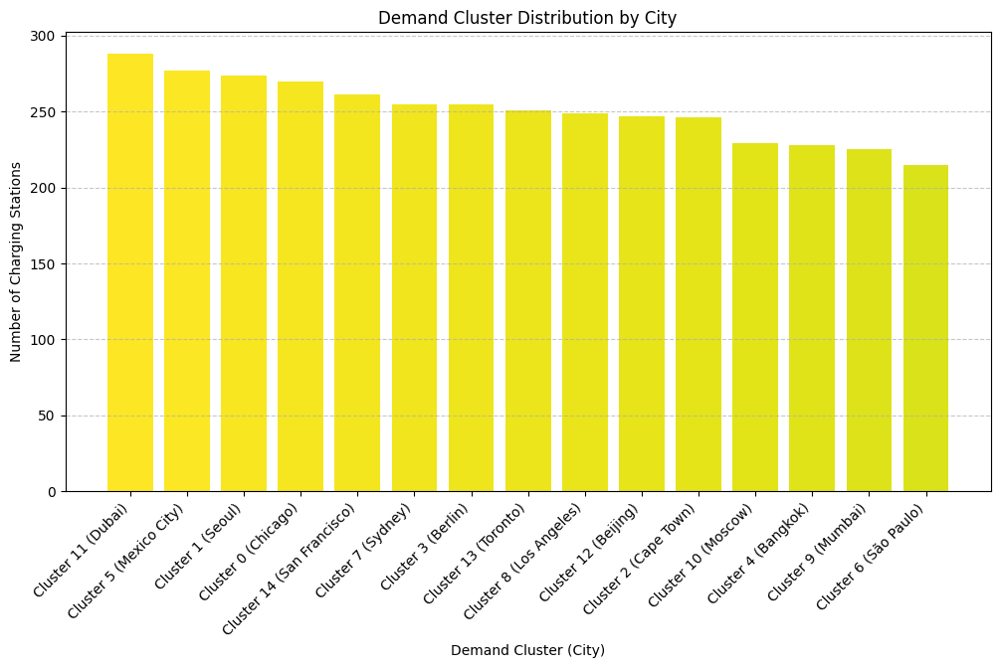

In [ ]:
import matplotlib.pyplot as plt

# Ensuring the data is sorted for correct visualization
demand_cluster_counts = demand_cluster_counts.sort_values(by="station_count", ascending=False)

# Creating formatted labels for the x-axis
demand_cluster_counts["label"] = demand_cluster_counts.apply(lambda row: f"Cluster {row['demand_cluster']} ({row['city']})", axis=1)

# Plotting
plt.figure(figsize=(12, 6))
plt.bar(demand_cluster_counts["label"], demand_cluster_counts["station_count"], color=plt.cm.viridis_r(range(len(demand_cluster_counts))))

plt.xticks(rotation=45, ha="right")
plt.xlabel("Demand Cluster (City)")
plt.ylabel("Number of Charging Stations")
plt.title("Demand Cluster Distribution by City")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


## 6.8 Train an XGBoost Classifier

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report

# Trainn9gn an XGBoost Classifier
xgb_classifier = XGBClassifier(n_estimators=100, learning_rate=0.05, max_depth=6, random_state=42)
xgb_classifier.fit(X_train_class, y_train_class)

# Predictions
y_pred_xgb = xgb_classifier.predict(X_test_class)

# Model Evaluation
accuracy_xgb = accuracy_score(y_test_class, y_pred_xgb)
print("\nXGBoost Classification Performance:")
print(f"Accuracy: {accuracy_xgb:.4f}")
print("\nClassification Report:\n", classification_report(y_test_class, y_pred_xgb))



XGBoost Classification Performance:
Accuracy: 0.5239

Classification Report:
               precision    recall  f1-score   support

           0       0.59      0.82      0.69        56
           1       0.55      0.58      0.56        52
           2       0.52      0.47      0.49        49
           3       0.49      0.60      0.54        47
           4       0.51      0.35      0.41        52
           5       0.34      0.40      0.37        48
           6       0.42      0.41      0.42        41
           7       0.52      0.29      0.38        51
           8       0.50      0.69      0.58        42
           9       0.45      0.57      0.50        37
          10       0.47      0.37      0.41        49
          11       0.63      0.79      0.70        58
          12       0.44      0.53      0.48        47
          13       0.77      0.44      0.56        68
          14       0.62      0.53      0.57        57

    accuracy                           0.52       754
 

## 6.9 Tuning XGBoost using GridSearchCV

In [ ]:
from sklearn.model_selection import GridSearchCV
from xgboost import XGBClassifier

# Definiung hyperparameter grid for tuning
param_grid = {
    'n_estimators': [50, 100, 200, 300],  # Testing different values
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7]
}

# Performming Grid SearchCV
grid_search = GridSearchCV(XGBClassifier(random_state=42), param_grid, cv=3, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_class, y_train_class)

# Getting the best parameters
best_params = grid_search.best_params_
print(f"Best Parameters: {best_params}")

# Trainning the best model
best_xgb_model = XGBClassifier(**best_params, random_state=42)
best_xgb_model.fit(X_train_class, y_train_class)

# Evaluating the tuned model
y_pred_best_xgb = best_xgb_model.predict(X_test_class)
accuracy_best_xgb = accuracy_score(y_test_class, y_pred_best_xgb)

print(f"\nTuned XGBoost Accuracy: {accuracy_best_xgb:.4f}")


Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}

Tuned XGBoost Accuracy: 0.4854


# Step 7:  Train a Classification-Based Pricing Model

## 7.1  Modify Demand Mapping to Match Our Data

In [ ]:
import numpy as np

# Demand category mapping
demand_mapping = {i: 5 + (i * 5) for i in range(15)}  # Example: Cluster 0 → 5 users, Cluster 14 → 75 users

# Fuynctiuon that calculates expected revenue for a cluster, considering price elasticity.
def revenue(price, demand_model, X_test_cluster):

    if X_test_cluster.empty:
        return 0  # Skip empty clusters

    X_test_price = X_test_cluster.copy()
    X_test_price["cost_usd_per_kwh"] = price[0]

    # Predict demand category using the trained RF classifier
    demand_pred = demand_model.predict(X_test_price)

    # Map predicted demand clusters to expected users per day
    expected_demand = np.array([demand_mapping[d] for d in demand_pred])

    # Apply price elasticity (higher price = lower demand)
    # Increase the elasticity penalty
    elasticity_factor = np.exp(-3 * (price[0] - 0.30))  # Decently aggressive drop

    adjusted_demand = expected_demand * elasticity_factor

    return np.sum(price[0] * adjusted_demand)  # Total revenue for given price


## 7.2 Optimize Pricing Using scipy.optimize.minimize
We find the optimal price per kWh that maximizes revenue.

In [ ]:
from scipy.optimize import minimize

# Define the objective function (negative revenue to maximize it)
def objective(price):
    return -revenue(price, rf_classifier, X_test_class)  # Negate to maximize revenue

# Setting price range (min: $0.10/kWh, max: $0.50/kWh)
result = minimize(objective, x0=[0.25], bounds=[(0.10, 0.50)], method='L-BFGS-B')

# Getting the optimal price
optimal_price = result.x[0]
print(f"\nOptimal Charging Price per kWh: ${optimal_price:.2f}")



Optimal Charging Price per kWh: $0.33


## 7.3 Visualize Price vs. Revenue Curve

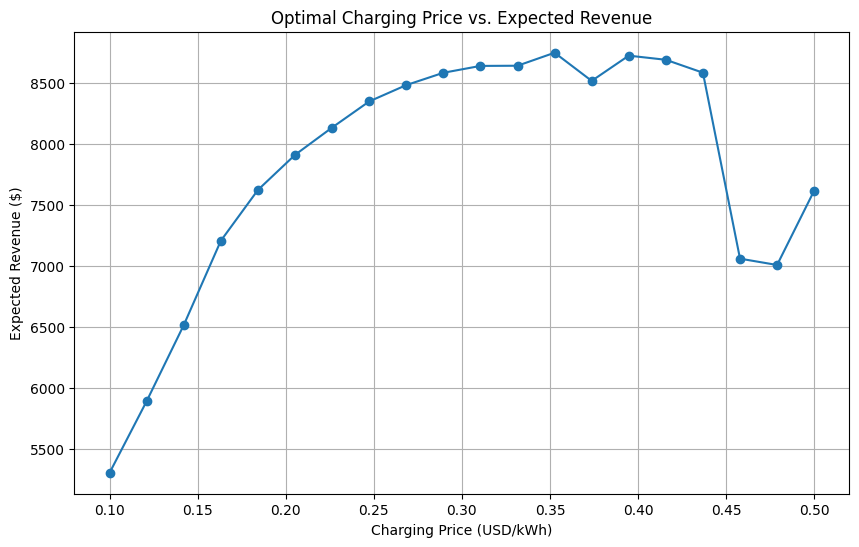

In [ ]:
import matplotlib.pyplot as plt

# Generating price values from $0.10 to $0.50
price_values = np.linspace(0.10, 0.50, 20)

# Calculating revenue for each price point
revenue_values = [-objective([p]) for p in price_values]

# Plotting Price vs. Revenue
plt.figure(figsize=(10, 6))
plt.plot(price_values, revenue_values, marker='o', linestyle='-')
plt.xlabel("Charging Price (USD/kWh)")
plt.ylabel("Expected Revenue ($)")
plt.title("Optimal Charging Price vs. Expected Revenue")
plt.grid(True)
plt.show()


## 7.4 Define Function to Optimize Pricing for Each City

In [ ]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize

# Function to calculate revenue per city using  our elasticity model
def revenue_per_city(price, demand_model, X_test_city):

    if X_test_city.empty:
        return 0  # Skip empty cities

    X_test_price = X_test_city.copy()
    X_test_price["cost_usd_per_kwh"] = price[0]

    # Predicttign demand category using trained RF classifier
    demand_pred = demand_model.predict(X_test_price)

    # Mapping demand clusters to expected users per day
    expected_demand = np.array([demand_mapping[d] for d in demand_pred])

    # Applying price elasticity (steeper demand drop at higher prices)
    elasticity_factor = np.exp(-3 * (price[0] - 0.30))  #  Decently aggressive drop-off
    adjusted_demand = expected_demand * elasticity_factor

    return np.sum(price[0] * adjusted_demand)  # Total revenue for given price


## 7.5 Optimize Charging Price for Each City

In [ ]:
import warnings
warnings.filterwarnings("ignore")
# Getting unique cities
cities = df_cleaned["city"].unique()

# Storing results
optimal_prices = []

for city in cities:
    print(f"Optimizing price for {city}...")

    # Filtering test data for the city
    X_test_city = X_test_class[df_cleaned["city"] == city]

    # Skipping if no data for the city
    if X_test_city.empty:
        continue

    # Defining objective function (negative revenue for maximization)
    def objective(price):
        return -revenue_per_city(price, rf_classifier, X_test_city)

    # Optimizing price for this city
    result = minimize(objective, x0=[0.25], bounds=[(0.10, 0.50)], method='L-BFGS-B')

    # Storing result
    optimal_prices.append({"City": city, "Optimal Price (USD/kWh)": result.x[0]})

# Convert to DataFrame
df_optimal_prices = pd.DataFrame(optimal_prices)

# Display results
df_optimal_prices


Optimizing price for San Francisco...
Optimizing price for Bangkok...
Optimizing price for Toronto...
Optimizing price for Mumbai...
Optimizing price for São Paulo...
Optimizing price for Moscow...
Optimizing price for Chicago...
Optimizing price for Beijing...
Optimizing price for Berlin...
Optimizing price for Seoul...
Optimizing price for Mexico City...
Optimizing price for Cape Town...
Optimizing price for Sydney...
Optimizing price for Los Angeles...
Optimizing price for Dubai...


,City,Optimal Price (USD/kWh)
0,San Francisco,0.312498
1,Bangkok,0.337754
2,Toronto,0.333333
3,Mumbai,0.500000
4,São Paulo,0.350003
5,Moscow,0.337500
6,Chicago,0.312500
7,Beijing,0.250000
8,Berlin,0.333333
9,Seoul,0.324854


## 7.6 Visualize City-Wise Pricing

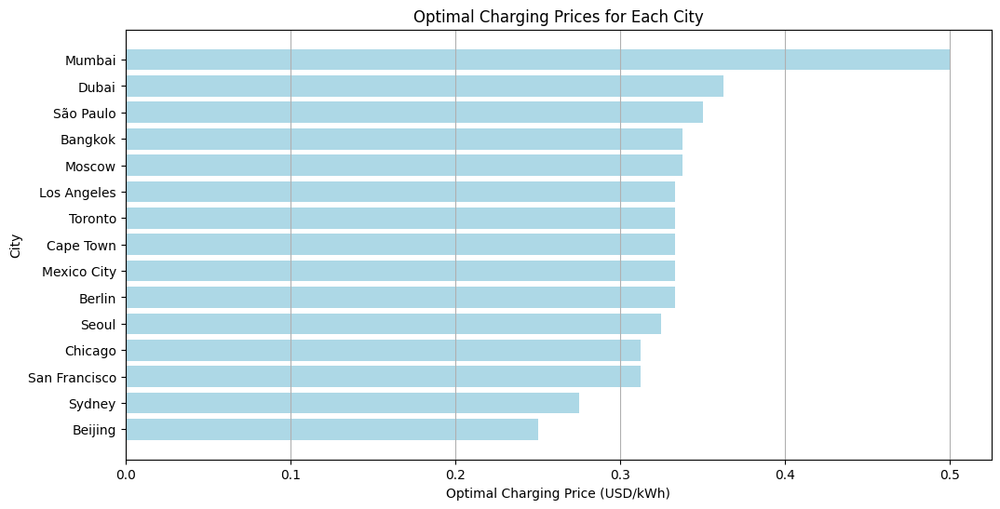

In [ ]:
import matplotlib.pyplot as plt

# Sortting by price for better visualization
df_optimal_prices_sorted = df_optimal_prices.sort_values(by="Optimal Price (USD/kWh)")

# Plotting
plt.figure(figsize=(12, 6))
plt.barh(df_optimal_prices_sorted["City"], df_optimal_prices_sorted["Optimal Price (USD/kWh)"], color="lightblue")
plt.xlabel("Optimal Charging Price (USD/kWh)")
plt.ylabel("City")
plt.title("Optimal Charging Prices for Each City")
plt.grid(axis="x")
plt.show()


# Step 8: Reinforcement Learning for Pricing

## 8.1 Define the State-Space

In [ ]:
import numpy as np
import pandas as pd
import random

# Demand levels
demand_levels = {"Low": 0, "Medium": 1, "High": 2}

# Defining price bins (10 bins)
price_bins = np.round(np.linspace(0.10, 0.50, 10), 2)
competitor_bins = np.round(np.linspace(0.10, 0.50, 10), 2)

# Defining action space (Increase, Decrease, Keep Price)
actions = [-0.05, 0.00, 0.05]

# Defining state space (Demand x Price x Competitor Price)
state_space = [(d, p, c) for d in demand_levels.values() for p in price_bins for c in competitor_bins]

# Initializing Q-table with string-based indexing
Q_table = pd.DataFrame(0, index=pd.MultiIndex.from_tuples(state_space, names=["Demand Level", "Current Price", "Competitor Price"]),
                       columns=actions)
Q_table = Q_table.astype(float)


## 8.2 Implement Q-Learning for Pricing

In [ ]:
def calculate_reward(price, demand, competitor_price):
    """
    Reward function: Encourages price increases when demand is high,
    while still penalizing overpricing.
    """
    base_demand = {0: 5, 1: 15, 2: 30}  # Low, Medium, High demand levels
    demand_effect = base_demand[demand] * np.exp(-1.5 * (price - competitor_price))  # Reduce penalty

    # Introduce extra reward for high-demand situations
    high_demand_bonus = 5 if demand == 2 and price >= competitor_price else 0

    penalty = max(0, (price - competitor_price) * 3)  # Reduce penalty from 5 to 3

    revenue = price * demand_effect + high_demand_bonus  # Add bonus for high demand
    return revenue - penalty


# Q-Learning Hyperparameters
alpha = 0.2  # Learning rate
gamma = 0.9  # Discount factor
epsilon = 1.0  # Initial exploration rate
epsilon_decay = 0.997  # Slower decay to keep exploring longer
epsilon_min = 0.1
episodes = 1000  # 1000 for better learning

# Trainnifgn Q-Learning Model
for episode in range(episodes):
    demand = random.choice(list(demand_levels.values()))
    price = str(round(random.choice(price_bins), 2))  # Converttoing to string
    competitor_price = str(round(random.choice(competitor_bins), 2))  # Convertting to string

    state = (demand, price, competitor_price)

    for step in range(10):  #  10 steps per episode
        if state not in Q_table.index:
            Q_table.loc[state] = 0  # Initializing missing state

        # Choose action (epsilon-greedy policy)
        if random.uniform(0, 1) < epsilon:
            action = random.choice(actions)  # Exploring
        else:
            action = Q_table.loc[state, :].idxmax()  # Exploiting best action

        # Applying action
        new_price = str(round(max(0.10, min(0.50, float(price) + action)), 2))  # Keeping within bounds
        new_state = (demand, new_price, competitor_price)

        if new_state not in Q_table.index:
            Q_table.loc[new_state] = 0  # Ensurng new state exists

        # Calculating reward
        reward = calculate_reward(float(new_price), demand, float(competitor_price))

        # Q-Learning update rule
        Q_table.loc[state, action] = (1 - alpha) * Q_table.loc[state, action] + \
                                     alpha * (reward + gamma * Q_table.loc[new_state, :].max())

        state = new_state

    if epsilon > epsilon_min:
        epsilon *= epsilon_decay  # Reducing exploration over time

optimized_pricing_policy = Q_table.idxmax(axis=1).reset_index()
optimized_pricing_policy.columns = ["Demand Level", "Current Price", "Competitor Price", "Optimal Price Adjustment"]
optimized_pricing_policy


,Demand Level,Current Price,Competitor Price,Optimal Price Adjustment
0,0,0.1,0.1,-0.05
1,0,0.1,0.14,-0.05
2,0,0.1,0.19,-0.05
3,0,0.1,0.23,-0.05
4,0,0.1,0.28,-0.05
...,...,...,...,...
817,2,0.15,0.1,-0.05
818,1,0.42,0.19,-0.05
819,0,0.27,0.19,-0.05
820,2,0.15,0.37,-0.05


# Step 9: Validate Charging Station Placement Model

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd
import folium
from shapely.geometry import Point
import numpy as np

# 1. Loading and Prepare Data

# Assuming `df_existing` contains existing station locations and `df_optimized` contains optimized locations
df_existing = df_cleaned.copy()  # Existing charging stations
df_optimized_new = df_optimized[df_optimized["Optimized_Station"] == 1]  # New optimized stations

# Loading the land shapefile  again for reference
land = gpd.read_file("/content/drive/MyDrive/10m_physical/ne_10m_land.shp")


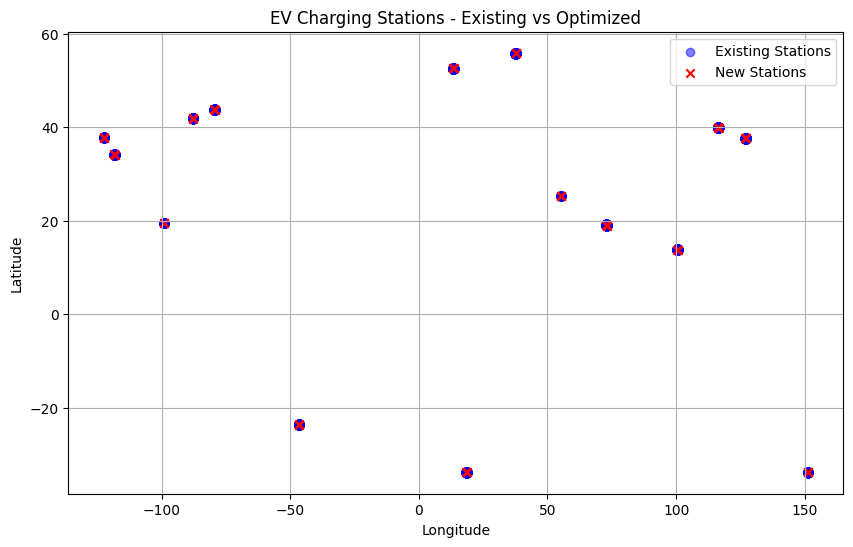

In [ ]:
# 2. Plotting Geospatial Heatmap of Charging Stations

plt.figure(figsize=(10, 6))

# Plotting existing charging stations
plt.scatter(df_existing["longitude"], df_existing["latitude"], c="blue", alpha=0.5, label="Existing Stations")

# Plotting optimized new stations
plt.scatter(df_optimized_new["longitude"], df_optimized_new["latitude"], c="red", marker="x", label="New Stations")

plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("EV Charging Stations - Existing vs Optimized")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# 3. Creating a Folium Map for Visualization

# Create a Folium map centered at the average station location
center_lat, center_long = df_existing["latitude"].mean(), df_existing["longitude"].mean()
map_stations = folium.Map(location=[center_lat, center_long], zoom_start=6)

# Plotting existing stations in blue
for _, row in df_existing.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=3,
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.7,
        popup=f"Existing Station - {row['city']}"
    ).add_to(map_stations)

# Plotting optimized stations in red
for _, row in df_optimized_new.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"New Optimized Station - {row['city']}",
        icon=folium.Icon(color="red", icon="bolt")
    ).add_to(map_stations)

print("Displaying optimized station placement map:")
display(map_stations)

Displaying optimized station placement map:


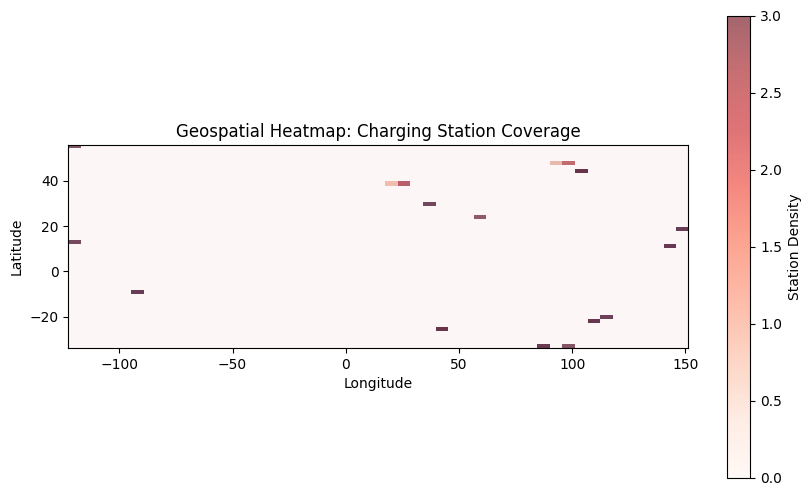

 Station coverage analysis complete!


In [ ]:
# 4. Assess Coverage ie. Identify Areas Needing More Stations

# Defininmg grid for station density estimation
grid_lat = np.linspace(df_existing["latitude"].min(), df_existing["latitude"].max(), 50)
grid_long = np.linspace(df_existing["longitude"].min(), df_existing["longitude"].max(), 50)

# Calculating station density
density_existing, _, _ = np.histogram2d(df_existing["latitude"], df_existing["longitude"], bins=[grid_lat, grid_long])
density_optimized, _, _ = np.histogram2d(df_optimized_new["latitude"], df_optimized_new["longitude"], bins=[grid_lat, grid_long])

# Heatmap of station coverage
plt.figure(figsize=(10, 6))
plt.imshow(density_existing.T, origin="lower", extent=[grid_long.min(), grid_long.max(), grid_lat.min(), grid_lat.max()], cmap="Blues", alpha=0.6)
plt.imshow(density_optimized.T, origin="lower", extent=[grid_long.min(), grid_long.max(), grid_lat.min(), grid_lat.max()], cmap="Reds", alpha=0.6)
plt.colorbar(label="Station Density")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Geospatial Heatmap: Charging Station Coverage")
plt.show()

print(" Station coverage analysis complete!")

# Step 10: Validate Pricing & Demand Models

RF-Based Demand Prediction Model Performance:
R² Score: 0.3314
Mean Absolute Error (MAE): 2.12
Root Mean Squared Error (RMSE): 3.68


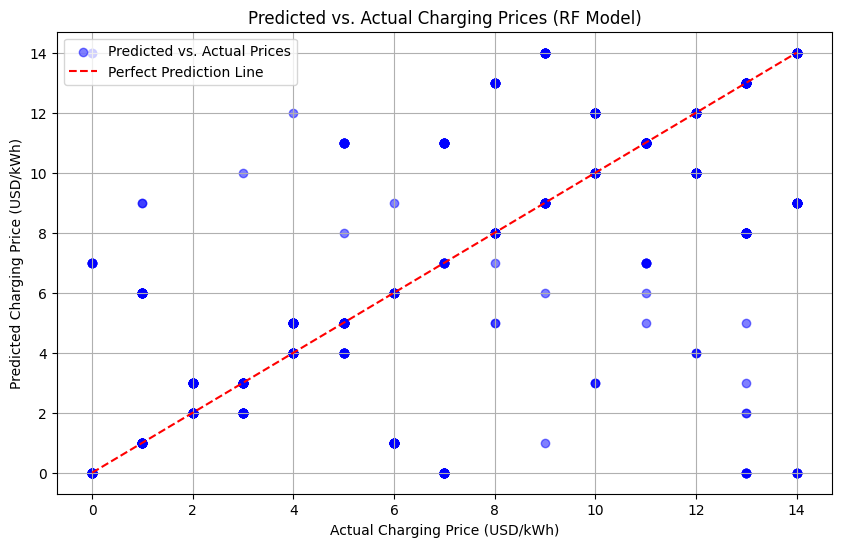

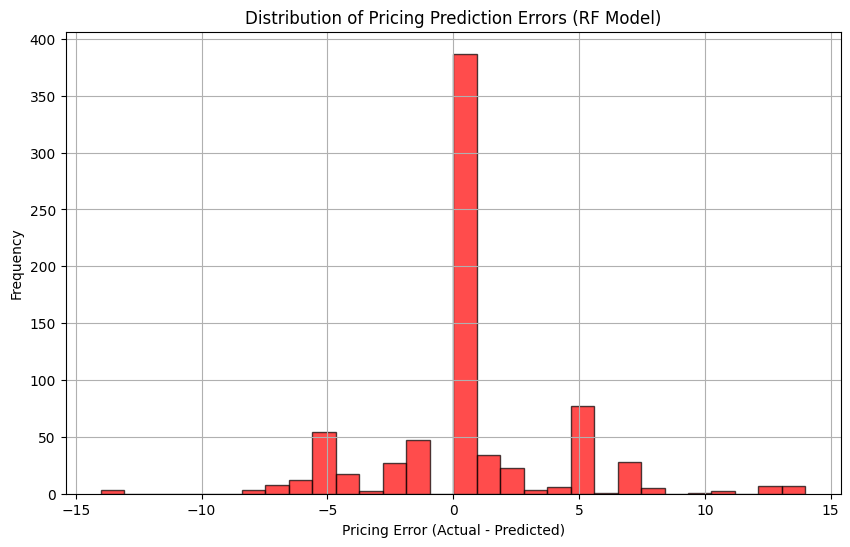

RF-Based Pricing Model Error Analysis:
Mean Absolute Error (MAE): 2.12
Root Mean Squared Error (RMSE): 3.68
Validation of Pricing & Demand Models Using RF Classifier Complete!


In [ ]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# 1. Testing Demand Prediction Model Using RF Classifier

# Predicting demand using the trained Random Forest model
y_pred_demand = rf_classifier.predict(X_test_class)

# Evaluating model performance
r2_demand = r2_score(y_test_class, y_pred_demand)
mae_demand = mean_absolute_error(y_test_class, y_pred_demand)
rmse_demand = np.sqrt(mean_squared_error(y_test_class, y_pred_demand))

print(f"RF-Based Demand Prediction Model Performance:")
print(f"R² Score: {r2_demand:.4f}")
print(f"Mean Absolute Error (MAE): {mae_demand:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse_demand:.2f}")

# 2. Compare Predicted Pricing vs. Actual Pricing Using RF Classifier

# Predictinb optimal prices using RF model
predicted_prices = rf_classifier.predict(X_test_class)

# Comparing with actual station prices
actual_prices = y_test_class

plt.figure(figsize=(10, 6))
plt.scatter(actual_prices, predicted_prices, alpha=0.5, color="blue", label="Predicted vs. Actual Prices")
plt.plot([actual_prices.min(), actual_prices.max()], [actual_prices.min(), actual_prices.max()], linestyle="--", color="red", label="Perfect Prediction Line")
plt.xlabel("Actual Charging Price (USD/kWh)")
plt.ylabel("Predicted Charging Price (USD/kWh)")
plt.title("Predicted vs. Actual Charging Prices (RF Model)")
plt.legend()
plt.grid(True)
plt.show()

# 3. Conduct Error Analysis & Refinements

# Calculating pricing error
pricing_error = actual_prices - predicted_prices

plt.figure(figsize=(10, 6))
plt.hist(pricing_error, bins=30, color="red", alpha=0.7, edgecolor="black")
plt.xlabel("Pricing Error (Actual - Predicted)")
plt.ylabel("Frequency")
plt.title("Distribution of Pricing Prediction Errors (RF Model)")
plt.grid(True)
plt.show()

# Displaying summary of pricing errors
pricing_mae = mean_absolute_error(actual_prices, predicted_prices)
pricing_rmse = np.sqrt(mean_squared_error(actual_prices, predicted_prices))

print(f"RF-Based Pricing Model Error Analysis:")
print(f"Mean Absolute Error (MAE): {pricing_mae:.2f}")
print(f"Root Mean Squared Error (RMSE): {pricing_rmse:.2f}")

print("Validation of Pricing & Demand Models Using RF Classifier Complete!")
